In [1]:
import sys
from pathlib import Path

from tifffile import imread

import numpy as np
import torch

from scipy.ndimage import zoom


sys.path.insert(0, "../utils")
from norm_percentile_nocrop import norm_percentile_nocrop
from utils.predict_by_parts import predict_by_parts
from utils.organized import split_nuclei, balloon

src_path = Path("../../data_zenodo/NHDF/NHDF_8h PI/IR 0,5Gy_8h PI")
model_path = "segmentation_model.pt"
img_folders = sorted(src_path.glob("*"))


resized_img_size = [505, 681, 48]  # image is resized to this size
normalization_percentile = 0.0001  # image is normalized into this percentile range
mask_erosion = [14, 14, 5]  # amount of mask erosion (elipsoid)

minimal_nuclei_size = 10000
h = 2
min_dist = 35

crop_size = [96, 96]

device = torch.device("cpu")

X, Y, Z = np.meshgrid(
    np.linspace(-1, 1, mask_erosion[0]),
    np.linspace(-1, 1, mask_erosion[1]),
    np.linspace(-1, 1, mask_erosion[2]),
)
sphere = np.sqrt(X**2 + Y**2 + Z**2) < 1


model = torch.load(model_path, map_location=torch.device("cpu"))

In [2]:
def predict_nn(data_path):
    img_path = data_path / "data_53BP1.tif"
    img_filename = str(img_path)
    img = []
    img.append(imread(img_filename))  # red
    img.append(imread(img_filename.replace("53BP1", "gH2AX")))  # green
    img.append(imread(img_filename.replace("53BP1", "DAPI")))  # DAPI
    img = np.stack(img, axis=3)

    original_img_size = img.shape[:3]

    factor = np.array(resized_img_size) / np.array(original_img_size)

    tmp_size = resized_img_size.copy()
    tmp_size.append(img.shape[3])
    img_resized = np.zeros(tmp_size, dtype=np.float32)
    for channel in range(img.shape[3]):

        data_one_channel = img[..., channel]

        data_one_channel = zoom(data_one_channel, factor, order=1)
        data_one_channel = norm_percentile_nocrop(
            data_one_channel, normalization_percentile
        )

        img_resized[..., channel] = data_one_channel

    img = img_resized

    img = img.astype(np.float32)
    img = np.transpose(img, (3, 0, 1, 2)).copy()
    img = torch.from_numpy(img)
    img = img.to(device)

    mask_predicted = predict_by_parts(model, img, crop_size=crop_size)
    mask_predicted = mask_predicted.detach().cpu().numpy()[0, :, :, :]
    mask_predicted -= mask_predicted.min()
    mask_predicted /= mask_predicted.max()

    mask_split = split_nuclei(
        mask_predicted > 0.75, minimal_nuclei_size, h, sphere, min_dist
    )

    mask_label_dilated = balloon(mask_split, sphere)

    factor = np.array(original_img_size) / np.array(mask_label_dilated.shape)
    mask_final = zoom(mask_label_dilated, factor, order=0)
    return mask_final


In [3]:
index = "0001"
data_path = src_path / index
output_path = data_path / "nuclei_mask.npy"
mask_final = predict_nn(data_path)
np.save(output_path, mask_final)

/var/folders/4q/tfzvg1g50hd89pj_w0mm6tn40000gn/T/ipykernel_29874/3803325737.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_lbl = cm.get_cmap("nipy_spectral")


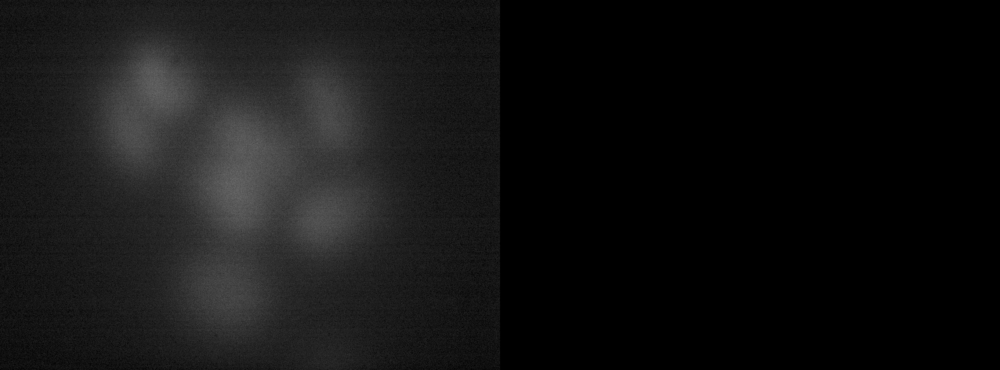

'mask_vs_original_slices.gif'

In [4]:
import numpy as np
import imageio.v2 as imageio
import matplotlib.cm as cm
from IPython.display import Image, display
from tifffile import imread

# Side-by-side GIF: original (left) + predicted labels (right)
gif_path = "mask_vs_original_slices.gif"

# Load an "original" image volume to show next to the mask.
# Default: DAPI channel, fallback to 53BP1 if DAPI is missing.
orig_path = data_path / "data_DAPI.tif"
if not orig_path.exists():
    orig_path = data_path / "data_53BP1.tif"
orig = imread(str(orig_path))

H, W, Z = mask_final.shape

# Colormap for labels (right panel)
vmax_lbl = float(np.max(mask_final))
if vmax_lbl <= 0:
    vmax_lbl = 1.0
cmap_lbl = cm.get_cmap("nipy_spectral")

# Normalize original (left panel) to 0..255 for display
orig = orig.astype(np.float32)
p1, p99 = np.percentile(orig, [1, 99])
if p99 <= p1:
    p1, p99 = float(np.min(orig)), float(np.max(orig) if np.max(orig) > np.min(orig) else np.min(orig) + 1.0)

frames = []
for z in range(Z):
    # Left: original slice -> RGBA
    sl0 = orig[:, :, z]
    sl0 = (sl0 - p1) / (p99 - p1)
    sl0 = np.clip(sl0, 0, 1)
    gray = (sl0 * 255).astype(np.uint8)
    left_rgba = np.stack([gray, gray, gray, np.full_like(gray, 255)], axis=2)

    # Right: label slice -> RGBA
    sl1 = (mask_final[:, :, z].astype(np.float32) / vmax_lbl)
    right_rgba = (cmap_lbl(sl1) * 255).astype(np.uint8)  # (H, W, 4)

    # Concatenate side-by-side
    frame = np.concatenate([left_rgba, right_rgba], axis=1)
    frames.append(frame)

imageio.mimsave(gif_path, frames, duration=0.08)
display(Image(filename=gif_path))
gif_path